In [13]:
import plotly.graph_objects as go

def fig(x, y, title=None) -> go.Figure:
    return go.Figure(
        # Loading the data into the figur
        data=[go.Scatter(x=x, y=y,
                        mode="lines",
                        line=dict(width=2, color="blue"))],
        # Setting the layout of the graph
        layout=go.Layout(
            xaxis=dict(range=[x.min(), x.max()], autorange=False),
            yaxis=dict(range=[y.min(), y.max() * 0.95 if y.max() < 0 else y.max() * 1.05], autorange=False),
            title=title,
        ))

def figs(xs, ys, names=None, title=None) -> go.Figure:
    if names is None:
        names = [None] * len(xs)
    return go.Figure(
        # Loading the data into the figur
        data=[go.Scatter(x=x, y=y, name=name,
                        mode="lines",
                        line=dict(width=2)) for x, y, name in zip(xs, ys, names)],
        # Setting the layout of the graph
        layout=go.Layout(
            xaxis=dict(range=[xs[0].min(), xs[0].max()], autorange=False),
            yaxis=dict(range=[ys[0].min(), ys[0].max()*1.01], autorange=False),
            title=title,
        ))

## Log likelihood

$
\mathcal{L}(\mathbf{X}|\boldsymbol{\theta}) = \prod_{i=1}^{N} p(x_i|\boldsymbol{\theta})
$

$
\log \mathcal{L}(\mathbf{X}|\boldsymbol{\theta}) = \sum_{i=1}^{N} \log p(x_i|\boldsymbol{\theta})
$

In [14]:
def log_likelihood(X, theta, dist):
    return np.sum(np.log(dist(X, theta)))

## Bernoulli分布

$
p(x) = \theta^x(1-\theta)^{(1-x)}
$

In [15]:
import numpy as np

@np.vectorize
def bernoulli(x, theta):
    assert 0 <= theta <= 1
    assert x in (0, 1)
    return theta ** x * (1 - theta) ** (1 - x)

## Maximum Likelihood (最尤推定)

$
\frac{\mathrm{d} \log \mathcal{L}(\mathbf{X}|\theta)}{\mathrm{d} \theta}
= \frac{\mathrm{d}}{\mathrm{d} \theta} \sum_{i=1}^{N} \{ x_i \log\theta + (1-x_i) \log{(1-\theta)} \}
= \sum_{i=1}^{N} \left( \frac{x_i}{\theta} - \frac{1-x_i}{1-\theta} \right)
$

$
\theta = \frac{1}{N} \sum_{i=1}^{N} x_i
$

In [16]:
import numpy as np
from typing import Callable

p = 0.3
samples = np.random.choice(a=[1,0], size=100, p=[p, 1-p])

thetas = np.linspace(0, 1, 101)[1:-1]
Ls = np.array([log_likelihood(samples, theta, bernoulli) for theta in thetas])
fig(thetas, Ls, title='Log likelihood').show()

## Bayes' theorem

$
p(\boldsymbol{\theta}|\mathbf{X}) \propto p(\mathbf{X}|\boldsymbol{\theta}) p(\boldsymbol{\theta})
$

$p(\boldsymbol{\theta})$: prior (事前分布)  
$p(\boldsymbol{\theta}|\mathbf{X})$: posterior (事後分布)  
これらはパラメータ$\theta$の分布であることに注意

## Beta (ベータ分布)

$
p(\theta|\alpha, \beta) = \frac{1}{B(\alpha, \beta)}\theta^{\alpha-1}(1-\theta)^{(\beta-1)}
$

In [17]:
from scipy import stats

def beta(x, theta):
    assert len(theta) == 2
    a = theta[0]
    b = theta[1]
    assert a > 0 and b > 0
    assert all(0 <= x) and all(x <= 1)
    return stats.beta.pdf(x, a, b)


x = np.linspace(0, 1, 51)

ps = zip(*[(x, beta(x, theta), str(theta)) for theta in [(2, 5), (1, 1), (0.5, 0.5), (1, 3), (5, 1), (2, 2)]])
figs(*ps, title='Beta').show()

## 尤度をベルヌーイ分布、事前分布をベータ分布としたときの事後分布

$
p(\theta|\mathbf{X}) \propto p(\mathbf{X}|\theta) p(\theta) 
= \left(\prod_{i=1}^N \theta^{x_i}(1-\theta)^{1-x_i} \right) \theta^{\alpha-1}(1-\theta)^{\beta-1}
= \theta^{\hat\alpha-1}(1-\theta)^{\hat\beta-1}
$

$\hat\alpha=\sum_{i=1}^{N}x_i+\alpha$  
$\hat\beta=\sum_{i=1}^{N}(1-x_i)+\beta$

$
p(\theta|\mathbf{X}) = \mathrm{Beta}(\theta|\hat\alpha, \hat\beta)
$

となり、事前分布と事後分布が共にBeta分布になる。  
しかも、元のハイパーパラメータ$\alpha, \beta$に観測値を足すだけというお手軽さ

In [18]:
def gen_gif():
    p = 0.1  # 真のコインの表が出る確率
    N = 500  # サンプルサイズ
    samples = np.random.choice(a=[1,0], size=N, p=[p, 1-p])
    csa, csb = np.cumsum(samples), np.cumsum(1 - samples)  # 累積和

    a, b = 1, 1  # 事前分布のハイパーパラメータ(無情報)
    x = np.linspace(0, 1, 1001)
    ys = [beta(x, theta=(sa + a, sb + b)) for sa, sb in zip(csa, csb)]
    mean = [a / (a + b) for a, b in zip(csa, csb)]
    var = [a * b / ((a + b) ** 2 * (a + b + 1)) for a, b in zip(csa, csb)]

    import gif

    @gif.frame
    def plot(i):
        m = round(mean[i], 2)
        s = round(var[i] ** 0.5, 3)
        title = f'Beta[n={i}, α={csa[i]-1}+1, β={csb[i]-1}+1, mean={m}, std={s}]'
        return fig(x, ys[i], title)

    frames = [plot(i) for i in [*range(100)] + [*range(100, N, 10)]]
    gif.save(frames, 'images/beta.gif', duration=100)

# gen_gif()

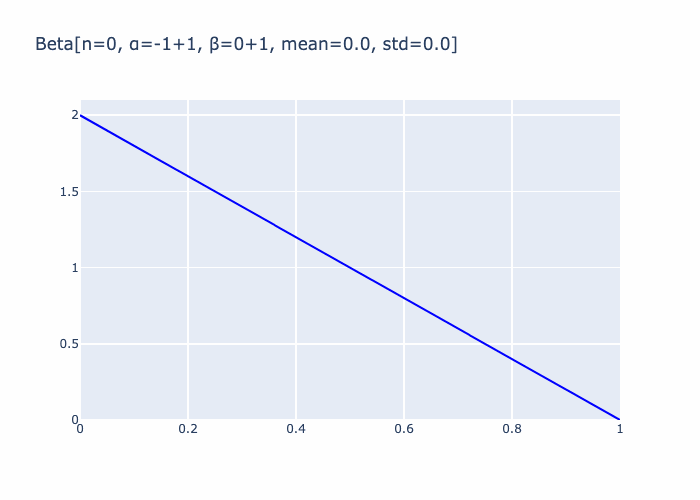

In [19]:
from IPython.display import Image

with open('images/beta.gif','rb') as f:
    image = Image(data=f.read(), format='png')
image

## 複数のBeta分布どっちがどれだけ優位か？

$p_A(\theta) = \mathrm{Beta}(\alpha_A,\beta_A)$  
$p_B(\theta) = \mathrm{Beta}(\alpha_B,\beta_B)$

In [20]:
from scipy import stats

theta_A = (10+1, 90+1)
theta_B = (12+1, 88+1)

x = np.linspace(0, 1, 1000)
pA, pB = beta(x, theta_A), beta(x, theta_B)

figs(xs=[x, x], ys=[pA, pB], names=['A', 'B'], title='Beta').show()

In [21]:
import plotly.graph_objs as go

N = int(5e5)
xA = stats.beta.rvs(*theta_A, size=N)
xB = stats.beta.rvs(*theta_B, size=N)

z = xB - xA
zN, zP = z[z <= 0], z[z > 0]

data = [
    go.Histogram(x=zN, xbins=dict(start=-1, end=1, size=0.01), name='Negative'),
    go.Histogram(x=zP, xbins=dict(start=-1, end=1, size=0.01), name='Positive'),
]

layout = go.Layout(
    title=f'Bを採用した時Aを上回る可能性: {len(zP)/len(z)*100:.1f}%',
    xaxis = dict(title="Z(B - A)", dtick=0.05),
    yaxis = dict(title="count"),
    bargap = 0.1,
)
go.Figure(data=data, layout=layout).show()

## 正規分布の場合

$
\mathcal{N}(x|\mu, \sigma^2) = \frac{1}{\sqrt{2\pi\sigma^2}} \exp \left\{ -\frac{(x-\mu)^2}{2\sigma^2}  \right\}
$

### 共役事前分布 ガウス-ガンマ分布([正規逆ガンマ分布](https://en.wikipedia.org/wiki/Normal-inverse-gamma_distribution))

ガウス分布とガンマ分布を掛けただけだが、$\lambda$で繋がっているため独立ではない点に注意  
$
p(\mu,\lambda)=\mathcal{NG}(\mu,\lambda|m,\beta,a,b)=\mathcal{N}(\mu|m,(\beta\lambda)^{-1})\mathrm{Gam}(\lambda|a,b)
$

### 更新式
$\hat{\beta} = N + \beta$  
$\hat{m} = \frac{1}{\hat\beta}\left( \sum_{i=1}^N x_i + \beta m \right)$  
$\hat{a}=\frac{N}{2}+a$  
$\hat{b}=\frac{1}{2} \left( \sum_{i=1}^{N} x_i^2+\beta m^2 - \hat\beta \hat{m}^2 \right) + b$

[参考](https://cartman0.hatenablog.com/entry/2019/06/16/%E6%AD%A3%E8%A6%8F%E9%80%86%E3%82%AC%E3%83%B3%E3%83%9E%E5%88%86%E5%B8%83%E3%81%AE%E4%BA%8B%E5%BE%8C%E5%88%86%E5%B8%83%E3%81%AE%E3%83%91%E3%83%A9%E3%83%A1%E3%83%BC%E3%82%BF%E6%9B%B4%E6%96%B0%E5%BC%8F#%E3%83%91%E3%83%A9%E3%83%A1%E3%83%BC%E3%82%BF%E3%81%AE%E5%B0%8E%E5%87%BA)

In [22]:
from scipy import stats
# 反響売り上げ5000円くらいとする
# s = sigma, sclae = e^mu
xs = stats.lognorm(s=0.3, scale=5000).rvs(10000)
log_xs = np.log(xs)

data = [go.Histogram(x=xs, xbins=dict(start=0, end=15000, size=500))]
layout = go.Layout(
    title=f'対数正規分布',
    xaxis = dict(title="x", dtick=500),
    yaxis = dict(title="count"),
    bargap = 0.1,
)
go.Figure(data=data, layout=layout).show()

data = [go.Histogram(x=log_xs, xbins=dict(start=7, end=12, size=0.1))]
layout = go.Layout(
    title=f'正規分布',
    xaxis = dict(title="x", dtick=0.1),
    yaxis = dict(title="count"),
    bargap = 0.1,
)
go.Figure(data=data, layout=layout).show()

In [23]:
m, beta, a, b = 0, 1, 1, 1  # ハイパーパラメータの初期化 

xs = stats.lognorm(s=0.3, scale=5000).rvs(10000)
xs = np.log(xs)
# 逐次更新
for x in xs:
    beta_ = beta + 1
    m_ = 1 / beta_ * (x + beta * m)
    a = 0.5 + a
    b = 0.5 * (x ** 2 + beta * m ** 2 - beta_ * m_ ** 2) + b
    m, beta = m_, beta_

print(m, beta, a, b)

def batch(xs, m=0, beta=1, a=1, b=1):
    beta_ = beta + len(xs)
    m_ = 1 / beta_ * (sum(xs) + beta * m)
    a_ = len(xs) / 2 + a
    b_ = 0.5 * (sum(map(lambda x: x*x, xs)) + beta * m ** 2 - beta_ * m_ ** 2) + b
    return m_, beta_, a_, b_

batch(xs)

8.511942733445997 10001 5001.0 495.17388724246393


(8.511942733445967, 10001, 5001.0, 495.1738872451242)